In [1]:
!pip install wordcloud
!pip install imbalanced-learn

In [2]:
#Import all libraries
import numpy as np
import pandas as pd
import nltk
import matplotlib.pyplot as plt
from wordcloud import WordCloud
from wordcloud import WordCloud, STOPWORDS
import string
import seaborn as sns
import plotly.graph_objects as go
from sklearn.decomposition import PCA
from gensim.models import Word2Vec, FastText
import warnings
from sklearn.model_selection import train_test_split
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.pipeline import Pipeline
from sklearn.metrics import accuracy_score, confusion_matrix , classification_report
from sklearn.preprocessing import LabelEncoder
warnings.filterwarnings('ignore')

In [3]:
#creating word cloud for given corpus  
def make_wordcloud(corpus , stopword):
    word_cloud = WordCloud(
            width=3000,
            height=2000,
            random_state=1,
            background_color="black",
            colormap="Pastel1",
            collocations=False,
            stopwords=stopword,
            ).generate(corpus)
    return word_cloud

In [4]:
#This function swaps 2 columns inside the dataframe
def swap_columns(df, col1, col2):
    col_list = list(df.columns)
    x, y = col_list.index(col1), col_list.index(col2)
    col_list[y], col_list[x] = col_list[x], col_list[y]
    df = df[col_list]
    return df

In [5]:
#This function removes punctuation from string
def remove_punctuations(text):
    for punctuation in string.punctuation:
        text = text.replace(punctuation, '')
    return text

In [6]:
#Reading dataset
Email_dataset = pd.read_csv("spam_ham_dataset.csv")

In [7]:
#Show dataset
Email_dataset.head()

,Unnamed: 0,label,text,label_num
0,605,ham,Subject: enron methanol ; meter # : 988291\r\n...,0
1,2349,ham,"Subject: hpl nom for january 9 , 2001\r\n( see...",0
2,3624,ham,"Subject: neon retreat\r\nho ho ho , we ' re ar...",0
3,4685,spam,"Subject: photoshop , windows , office . cheap ...",1
4,2030,ham,Subject: re : indian springs\r\nthis deal is t...,0


In [8]:
s=Email_dataset["label"].value_counts()
s

label
ham     3672
spam    1499
Name: count, dtype: int64

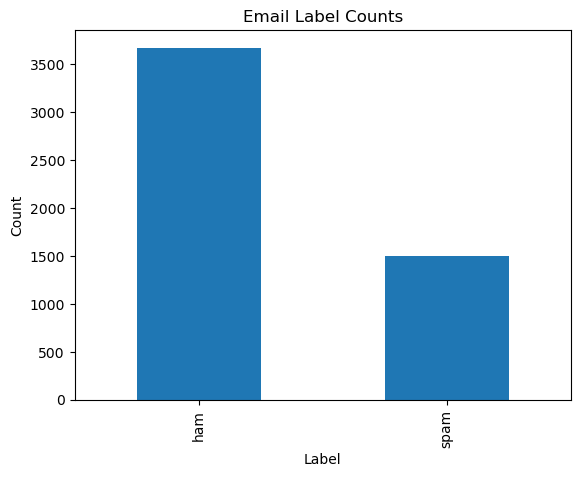

In [9]:
# create a bar chart
s.plot.bar()

# set the title and axis labels
plt.title("Email Label Counts")
plt.xlabel("Label")
plt.ylabel("Count")

# display the chart
plt.show()

In [10]:
#Dropping columns that are not needed
Email_dataset = Email_dataset.drop('Unnamed: 0', axis=1)
Email_dataset = Email_dataset.drop('label', axis=1)

In [11]:
Email_dataset.head()

,text,label_num
0,Subject: enron methanol ; meter # : 988291\r\n...,0
1,"Subject: hpl nom for january 9 , 2001\r\n( see...",0
2,"Subject: neon retreat\r\nho ho ho , we ' re ar...",0
3,"Subject: photoshop , windows , office . cheap ...",1
4,Subject: re : indian springs\r\nthis deal is t...,0


In [12]:
#Creating a new feature, extracting subject of each email
subjects = []
for i in range(len(Email_dataset)):
    ln = Email_dataset["text"][i]
    line = ""
    for i in ln:
        if(i == '\r'):
            break
        line = line + i
    line = line.replace("Subject" , "")
    subjects.append(line)

In [13]:
Email_dataset['Subject'] = subjects

In [14]:
#Renaming the dataframe columns
Email_dataset.columns = ["Email_text" , "Labels" , "Email_Subject"]

In [15]:
#Swapping the dataframe columns 
Email_dataset = swap_columns(Email_dataset, 'Labels', 'Email_Subject')

In [16]:
Email_dataset.head()

,Email_text,Email_Subject,Labels
0,Subject: enron methanol ; meter # : 988291\r\n...,: enron methanol ; meter # : 988291,0
1,"Subject: hpl nom for january 9 , 2001\r\n( see...",": hpl nom for january 9 , 2001",0
2,"Subject: neon retreat\r\nho ho ho , we ' re ar...",: neon retreat,0
3,"Subject: photoshop , windows , office . cheap ...",": photoshop , windows , office . cheap . main ...",1
4,Subject: re : indian springs\r\nthis deal is t...,: re : indian springs,0


In [17]:
#Converting all strings to lowercase
Email_dataset['Email_Subject'] = Email_dataset['Email_Subject'].str.lower()
Email_dataset['Email_text'] = Email_dataset['Email_text'].str.lower()

In [18]:
#Removing Punctuation from the data
Email_dataset['Email_Subject'] = Email_dataset['Email_Subject'].apply(remove_punctuations)
Email_dataset['Email_text'] = Email_dataset['Email_text'].apply(remove_punctuations)

In [19]:
Email_dataset.head()

,Email_text,Email_Subject,Labels
0,subject enron methanol meter 988291\r\nthis...,enron methanol meter 988291,0
1,subject hpl nom for january 9 2001\r\n see at...,hpl nom for january 9 2001,0
2,subject neon retreat\r\nho ho ho we re aroun...,neon retreat,0
3,subject photoshop windows office cheap mai...,photoshop windows office cheap main trending,1
4,subject re indian springs\r\nthis deal is to ...,re indian springs,0


In [20]:
#Creting seprate dataset for Spam and Non Spam emails, to perform analysis 
Spam = pd.DataFrame(columns = ['Email_text', 'Email_Subject', 'Labels'])
Non_Spam = pd.DataFrame(columns = ['Email_text', 'Email_Subject', 'Labels'])

In [21]:
import pandas as pd

# Tạo một DataFrame rỗng cho Non_Spam
Non_Spam = pd.DataFrame(columns=['Email_text', 'Email_Subject', 'Labels'])

# Lặp qua từng dòng trong Email_dataset và thêm vào Non_Spam nếu nhãn là 0
for i in range(len(Email_dataset)):
    if Email_dataset['Labels'][i] == 0:
        new_row = pd.DataFrame({
            'Email_text': [Email_dataset['Email_text'][i]],
            'Email_Subject': [Email_dataset['Email_Subject'][i]],
            'Labels': [Email_dataset['Labels'][i]]
        })
        Non_Spam = pd.concat([Non_Spam, new_row], ignore_index=True)


In [22]:
# Tạo DataFrame rỗng cho Spam
Spam = pd.DataFrame(columns=['Email_text', 'Email_Subject', 'Labels'])

# Lặp qua từng dòng trong Email_dataset và thêm vào Spam nếu nhãn là 1
for i in range(len(Email_dataset)):
    if Email_dataset['Labels'][i] == 1:
        # Tạo một DataFrame mới từ dòng phù hợp
        new_row = pd.DataFrame({
            'Email_text': [Email_dataset['Email_text'][i]],
            'Email_Subject': [Email_dataset['Email_Subject'][i]],
            'Labels': [Email_dataset['Labels'][i]]
        })
        # Sử dụng pd.concat để thêm vào Spam
        Spam = pd.concat([Spam, new_row], ignore_index=True)


In [23]:
Spam.head()

,Email_text,Email_Subject,Labels
0,subject photoshop windows office cheap mai...,photoshop windows office cheap main trending,1
1,subject looking for medication we re the bes...,looking for medication we re the best source,1
2,subject vocable rnd word asceticism\r\nvcsc ...,vocable rnd word asceticism,1
3,subject report 01405 \r\nwffur attion brom est...,report 01405,1
4,subject vic odin n ow\r\nberne hotbox carnal...,vic odin n ow,1


In [24]:
Non_Spam.head()

,Email_text,Email_Subject,Labels
0,subject enron methanol meter 988291\r\nthis...,enron methanol meter 988291,0
1,subject hpl nom for january 9 2001\r\n see at...,hpl nom for january 9 2001,0
2,subject neon retreat\r\nho ho ho we re aroun...,neon retreat,0
3,subject re indian springs\r\nthis deal is to ...,re indian springs,0
4,subject ehronline web address change\r\nthis m...,ehronline web address change,0


In [25]:
#creating stopwords corpus
more_stopwords = {'re' , 's' , 'subject','hpl','hou','enron'}
STOPWORDS = STOPWORDS.union(more_stopwords)

In [26]:
#creating spam subject corpus 
Subject_corpus_spam = ""
for i in range(len(Spam)):
    Subject_corpus_spam = Subject_corpus_spam + Spam['Email_Subject'][i]

In [27]:
#creating spam text corpus 
Text_corpus_spam = ""
for i in range(len(Spam)):
    Text_corpus_spam = Text_corpus_spam + Spam['Email_text'][i]

In [28]:
#creating non-spam subject corpus 
Subject_corpus_non_spam = ""
for i in range(len(Non_Spam)):
    Subject_corpus_non_spam = Subject_corpus_non_spam + Non_Spam['Email_Subject'][i]

In [29]:
#creating non-spam text corpus 
Text_corpus_non_spam = ""
for i in range(len(Non_Spam)):
    Text_corpus_non_spam = Text_corpus_non_spam + Non_Spam['Email_text'][i]

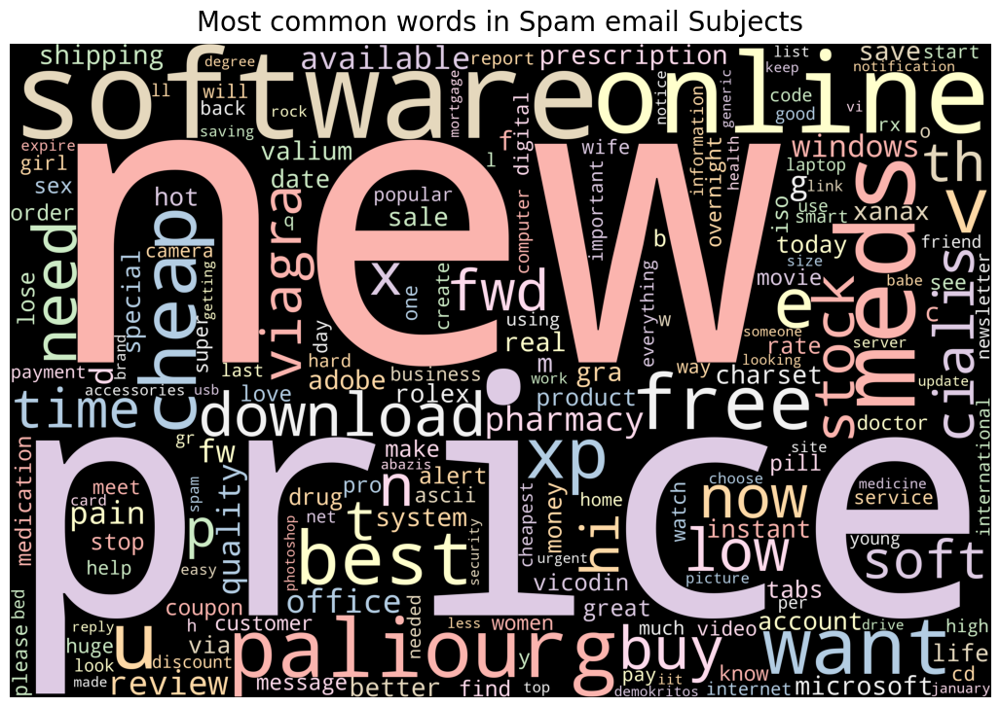

In [30]:
#plotting word cloud for Spam Subject corpus
Spam_Subject_wordcloud = make_wordcloud (Subject_corpus_spam , STOPWORDS)
plt.figure(figsize=(13, 13))
plt.title("Most common words in Spam email Subjects", fontdict={'size': 20, 'color': 'black', 
                                  'verticalalignment': 'bottom'})
plt.imshow(Spam_Subject_wordcloud)
plt.axis("off")
plt.show()

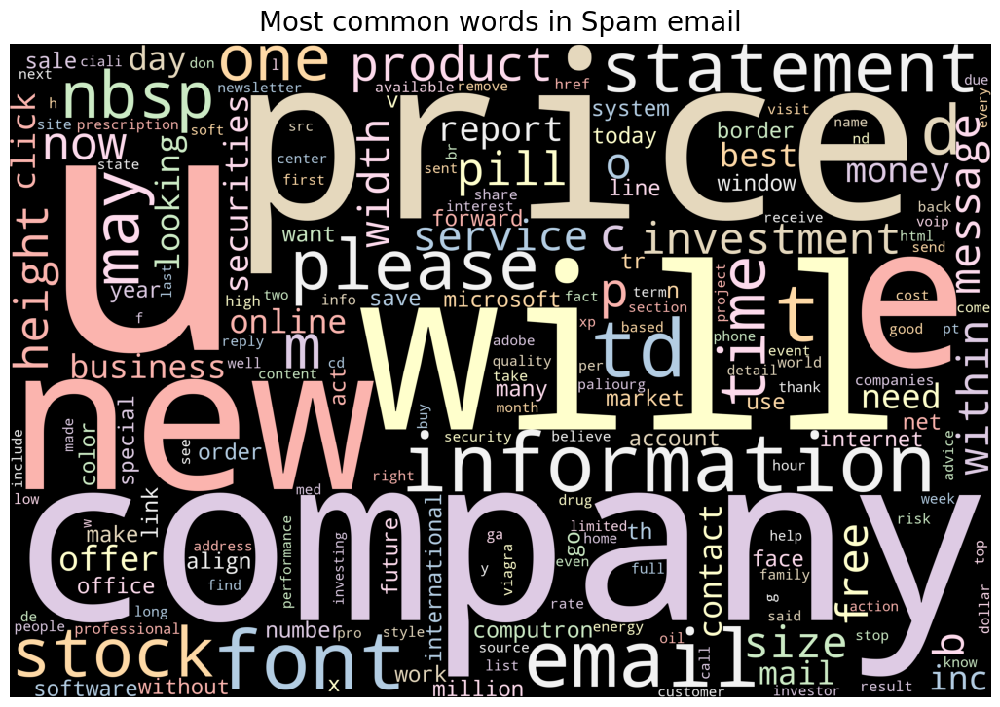

In [31]:
#plotting word cloud for Spam Text corpus
Spam_Text_wordcloud = make_wordcloud (Text_corpus_spam , STOPWORDS)
plt.figure(figsize=(13, 13))
plt.title("Most common words in Spam email", fontdict={'size': 20, 'color': 'black', 
                                  'verticalalignment': 'bottom'})
plt.imshow(Spam_Text_wordcloud)
plt.axis("off")
plt.show()

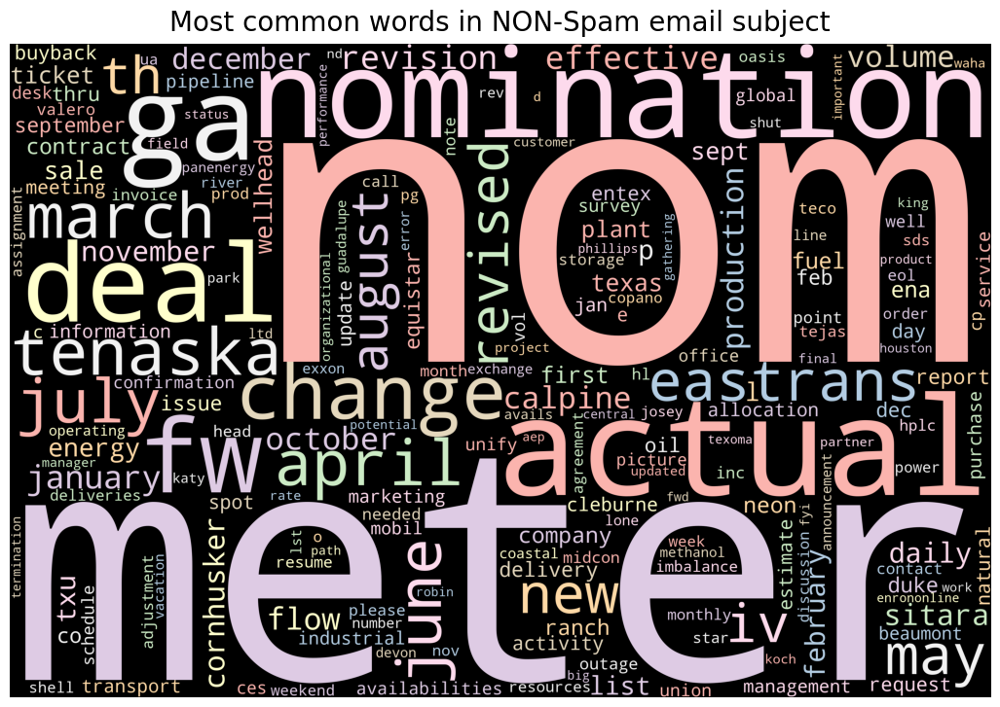

In [32]:
#plotting word cloud for Non Spam Subject corpus
Non_Spam_Subject_wordcloud = make_wordcloud (Subject_corpus_non_spam , STOPWORDS)
plt.figure(figsize=(13, 13))
plt.title("Most common words in NON-Spam email subject", fontdict={'size': 20, 'color': 'black', 
                                  'verticalalignment': 'bottom'})
plt.imshow(Non_Spam_Subject_wordcloud)
plt.axis("off")
plt.show()

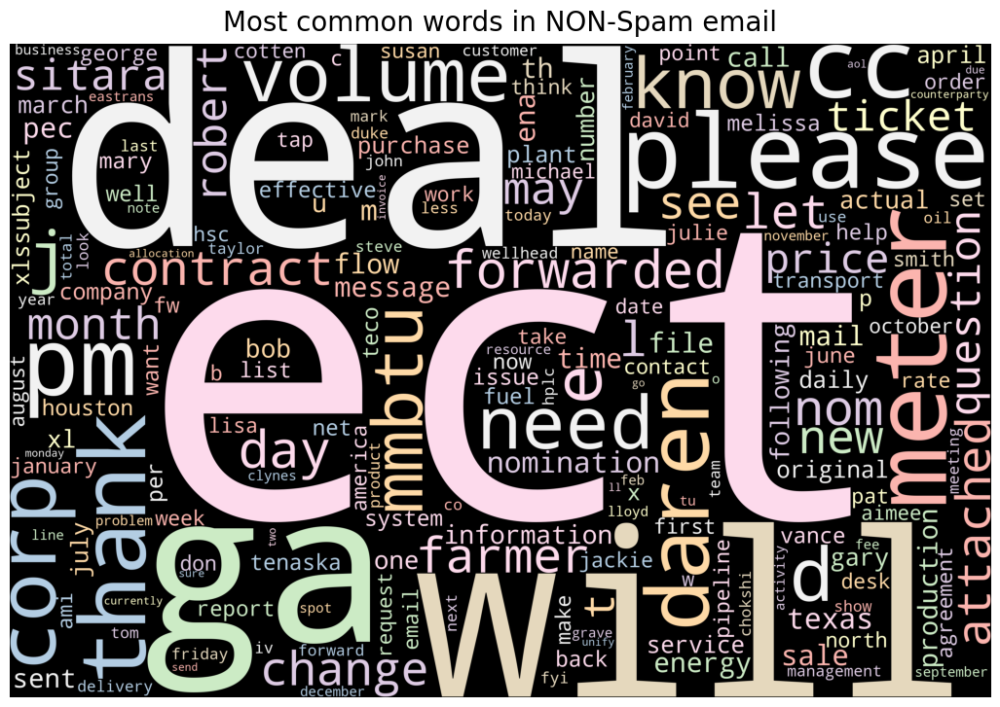

In [33]:
#plotting word cloud for Non Spam Text corpus
Non_Spam_Subject_wordcloud = make_wordcloud (Text_corpus_non_spam , STOPWORDS)
plt.figure(figsize=(13, 13))
plt.title("Most common words in NON-Spam email", fontdict={'size': 20, 'color': 'black', 
                                  'verticalalignment': 'bottom'})
plt.imshow(Non_Spam_Subject_wordcloud)
plt.axis("off")
plt.show()

In [34]:
import spacy
from spacy.lang.en.stop_words import STOP_WORDS
import string
import re

# Tải model Spacy
# Thay "en_core_web_lg" bằng gói model bạn muốn sử dụng
nlp = spacy.load("en_core_web_lg", disable=["parser", "ner"])
# Có thể tắt các component khác nhau để tăng tốc,
# nếu bạn không cần thông tin từ parser, NER,...

# Regex để loại bỏ URL, mention (@), và ký tự không phải chữ/số
text_cleaning_re = r"@\S+|https?:\S+|http?:\S|[^A-Za-z0-9]+"


def preprocess_texts(texts, n_process=4, batch_size=2000):
    """
    Tiền xử lý 1 list/Series văn bản bằng spaCy đa luồng.
    :param texts: list hoặc Series văn bản cần tiền xử lý
    :param n_process: số lượng process chạy song song
    :param batch_size: kích thước batch
    :return: generator chứa các văn bản đã tiền xử lý
    """

    # Hạn chế các thành phần không cần thiết (nếu đã disable ở trên)
    # Khi gọi nlp.pipe, spaCy sẽ trả về generator doc tương ứng
    docs = nlp.pipe(
        (re.sub(text_cleaning_re, " ", str(text).lower()).strip() for text in texts),
        n_process=n_process,
        batch_size=batch_size
    )

    for doc in docs:
        tokens = []
        for token in doc:
            # Bỏ qua những token không cần
            if token.is_punct or token.is_stop or token.like_num:
                continue

            lemma = token.lemma_.lower()

            # Bỏ qua nếu lemma rỗng hoặc là ký tự đặc biệt
            if lemma and lemma not in string.punctuation:
                tokens.append(lemma)

        # Trả về text đã được xử lý
        yield " ".join(tokens)


# Ví dụ áp dụng cho DataFrame pandas: X_train, X_test

# Tiền xử lý cột "text" của X_train
Spam["Email_text"] = list(preprocess_texts(Spam["Email_text"], n_process=8, batch_size=2000))
# Tiền xử lý cột "Subject" của X_train
Spam["Email_Subject"] = list(preprocess_texts(Spam["Email_Subject"], n_process=8, batch_size=2000))


In [35]:
#create a corpus conatininga all the email text
Email_text_corpus = []
for line in Email_dataset['Email_text']:
    words = line.split(" ")
    Email_text_corpus.append(words)

In [36]:
print(Email_dataset)

                                             Email_text  \
0     subject enron methanol  meter   988291\r\nthis...   
1     subject hpl nom for january 9  2001\r\n see at...   
2     subject neon retreat\r\nho ho ho  we  re aroun...   
3     subject photoshop  windows  office  cheap  mai...   
4     subject re  indian springs\r\nthis deal is to ...   
...                                                 ...   
5166  subject put the 10 on the ft\r\nthe transport ...   
5167  subject 3  4  2000 and following noms\r\nhpl c...   
5168  subject calpine daily gas nomination\r\n\r\n\r...   
5169  subject industrial worksheets for august 2000 ...   
5170  subject important online banking alert\r\ndear...   

                                          Email_Subject  Labels  
0                        enron methanol  meter   988291       0  
1                           hpl nom for january 9  2001       0  
2                                          neon retreat       0  
3      photoshop  windows  

In [37]:
#create a word2vec model for words in email text 
model = Word2Vec(Email_text_corpus, min_count=1, vector_size=56)

In [38]:
X = model.wv[model.wv.key_to_index ]
pca = PCA(n_components=2)
result = pca.fit_transform(X)
pca_df = pd.DataFrame(result, columns = ['x','y'])

In [39]:
#visualizing the corpus as a word vector
N = 1000000
words = list(model.wv.key_to_index)
fig = go.Figure(data=go.Scattergl(
   x = pca_df['x'],
   y = pca_df['y'],
   mode='markers',
   marker=dict(
       color=np.random.randn(N),
       colorscale='Viridis',
       line_width=1
   ),
   text=words,
   textposition="bottom center"
))

fig.show()

In [40]:
Email_dataset.head()

,Email_text,Email_Subject,Labels
0,subject enron methanol meter 988291\r\nthis...,enron methanol meter 988291,0
1,subject hpl nom for january 9 2001\r\n see at...,hpl nom for january 9 2001,0
2,subject neon retreat\r\nho ho ho we re aroun...,neon retreat,0
3,subject photoshop windows office cheap mai...,photoshop windows office cheap main trending,1
4,subject re indian springs\r\nthis deal is to ...,re indian springs,0


In [41]:
def sigmoid(x):
    return 1 / (1 + np.exp(-x))

In [42]:
def cost_function(h, y):
    return (-y * np.log(h + 1e-10) - (1 - y) * np.log(1 - h + 1e-10)).mean()

In [43]:
def gradient_descent(X, h, y):
    return np.dot(X.T, (h - y)) / y.shape[0]

In [44]:
def update_weight_loss(weight, learning_rate, gradient):
    return weight - learning_rate * gradient

In [45]:
X = Email_dataset['Email_text']
y = Email_dataset['Labels'].values

In [46]:
# Chia dữ liệu thành tập tạm (temporary set) và tập test
X_temp, X_test, y_temp, y_test = train_test_split(X, y, test_size=0.2, random_state=2004)

# Chia tiếp tập tạm thành tập train và tập validation (validation nhỏ hơn test)
X_train, X_val, y_train, y_val = train_test_split(X_temp, y_temp, test_size=0.15, random_state=2004)
# Lưu ý: test_size=0.15 ở đây nghĩa là 15% của tập tạm, tức là 80% * 15% = 12% của toàn bộ dữ liệu gốc.

In [47]:
X_train.info()

<class 'pandas.core.series.Series'>
Index: 3515 entries, 1283 to 4272
Series name: Email_text
Non-Null Count  Dtype 
--------------  ----- 
3515 non-null   object
dtypes: object(1)
memory usage: 54.9+ KB


In [48]:
# Fit the CountVectorizer on your training data
vectorizer = CountVectorizer()
X_train = vectorizer.fit_transform(X_train).toarray()

# Transform your test data using the same vectorizer
X_test = vectorizer.transform(X_test).toarray()
X_val = vectorizer.transform(X_val).toarray()

In [49]:
from imblearn.over_sampling import SMOTE
sm = SMOTE(random_state=42)
X_train, y_train = sm.fit_resample(X_train, y_train)

In [50]:
num_iter = 1000
learning_rate = 0.1
weight = np.zeros(X_train.shape[1])

In [51]:
costs = []

In [52]:
for i in range(num_iter):
    z = np.dot(X_train, weight)
    h = sigmoid(z)
    gradient = gradient_descent(X_train, h, y_train)
    weight = update_weight_loss(weight, learning_rate, gradient)
    
    if(i % 100 == 0):
        z = np.dot(X_train, weight)
        h = sigmoid(z)
        cost = cost_function(h, y_train)
        costs.append(cost)
        print(f'cost: {cost} \t')

cost: 0.5884019225832835 	


KeyboardInterrupt: 

In [53]:
print(X_train)

[[6 0 0 ... 0 0 0]
 [1 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 ...
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]
 [0 0 0 ... 0 0 0]]


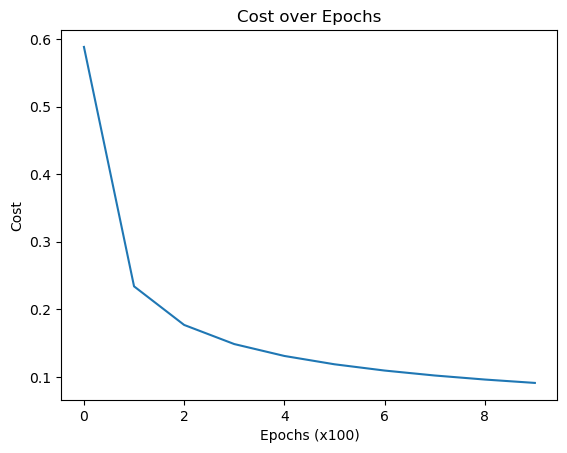

In [54]:
plt.plot(costs)
plt.xlabel('Epochs (x100)')
plt.ylabel('Cost')
plt.title('Cost over Epochs')
plt.show()

In [55]:
final_pred = sigmoid(np.dot(X_test, weight))
y_pred = final_pred.round()

In [56]:
label_name = ['Ham', 'Spam']

In [57]:
accuracy = accuracy_score(y_test, y_pred)
print(accuracy)

0.9516908212560387


In [58]:
from sklearn.metrics import classification_report
print(classification_report(y_test, y_pred, target_names=label_name))

              precision    recall  f1-score   support

         Ham       1.00      0.94      0.97       753
        Spam       0.86      0.99      0.92       282

    accuracy                           0.95      1035
   macro avg       0.93      0.96      0.94      1035
weighted avg       0.96      0.95      0.95      1035



Text(0.5, 1.0, 'Confusion Matrix for Logistic Regression')

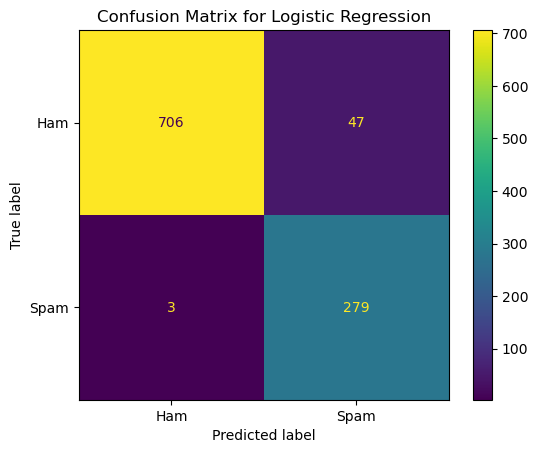

In [59]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
cm = confusion_matrix(y_test, y_pred)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=label_name)
disp.plot()
plt.gca().grid(False)
plt.title('Confusion Matrix for Logistic Regression')

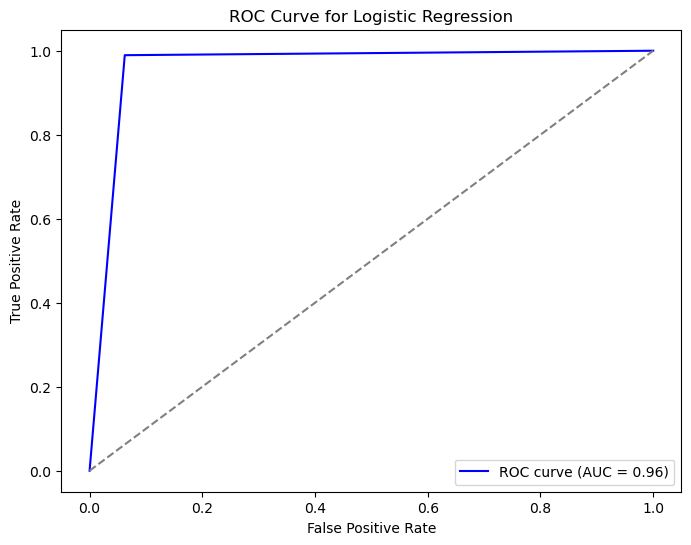

In [60]:
from sklearn.metrics import roc_curve, roc_auc_score
import matplotlib.pyplot as plt

# Tính ROC curve
fpr, tpr, thresholds = roc_curve(y_test, y_pred)

# Tính AUC
roc_auc = roc_auc_score(y_test, y_pred)

# Vẽ ROC curve
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='blue', label=f'ROC curve (AUC = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], color='gray', linestyle='--')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve for Logistic Regression')
plt.legend(loc="lower right")
plt.grid(False)
plt.show()


In [61]:
from sklearn.ensemble import RandomForestClassifier
import math
RF = RandomForestClassifier()
RF.fit(X_train, y_train)
y_pred_RF = RF.predict(X_test)
print(f'Accuracy on test set: {RF.score(X_test, y_test)}')


Accuracy on test set: 0.961352657004831


Text(0.5, 1.0, 'Confusion Matrix for Random Forest Classifier')

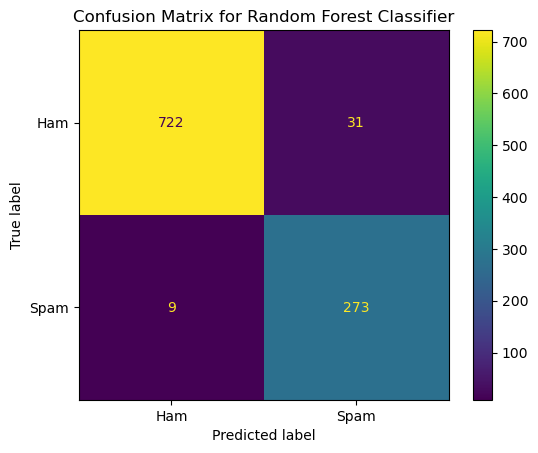

In [62]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
cm = confusion_matrix(y_test, y_pred_RF, labels=RF.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=label_name)
disp.plot()
plt.gca().grid(False)
plt.title("Confusion Matrix for Random Forest Classifier")

In [63]:
from sklearn.metrics import classification_report
print(classification_report(y_test, y_pred_RF, target_names=label_name))

              precision    recall  f1-score   support

         Ham       0.99      0.96      0.97       753
        Spam       0.90      0.97      0.93       282

    accuracy                           0.96      1035
   macro avg       0.94      0.96      0.95      1035
weighted avg       0.96      0.96      0.96      1035



In [64]:
from sklearn.neighbors import KNeighborsClassifier
KNC = KNeighborsClassifier(n_jobs=-1)
KNC.fit(X_train, y_train)
y_pred_KNN = KNC.predict(X_test)
print(f'Accuracy on test set: {KNC.score(X_test, y_test)}')


Accuracy on test set: 0.6811594202898551


Text(0.5, 1.0, 'Confusion Matrix for K-Nearest Neighbors Classifier')

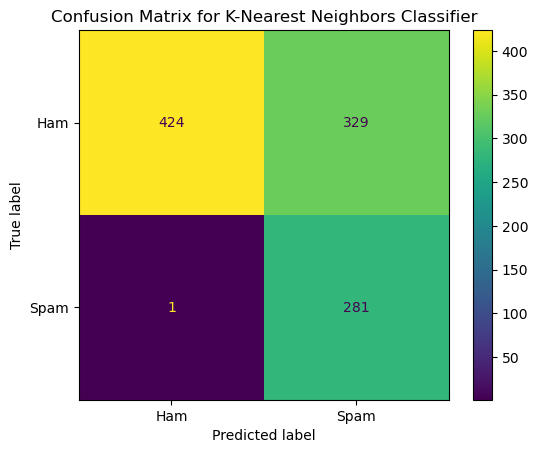

In [65]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
cm = confusion_matrix(y_test, y_pred_KNN, labels=KNC.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=label_name)
disp.plot()
plt.gca().grid(False)
plt.title("Confusion Matrix for K-Nearest Neighbors Classifier")

In [66]:
from sklearn.metrics import classification_report
print(classification_report(y_test, y_pred_KNN, target_names=label_name))

              precision    recall  f1-score   support

         Ham       1.00      0.56      0.72       753
        Spam       0.46      1.00      0.63       282

    accuracy                           0.68      1035
   macro avg       0.73      0.78      0.67      1035
weighted avg       0.85      0.68      0.70      1035



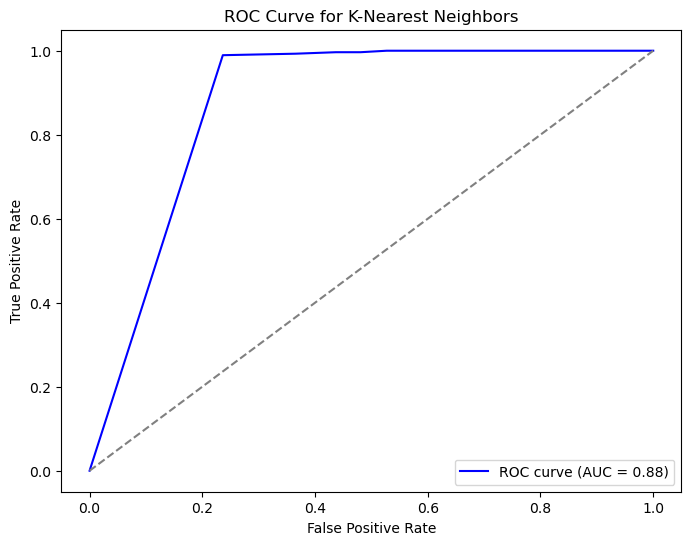

In [67]:
from sklearn.metrics import roc_curve, roc_auc_score

le = LabelEncoder()


y_pred_KNC_proba = KNC.predict_proba(X_test)[:, 1]
fpr, tpr, thresholds = roc_curve(le.fit_transform(y_test), y_pred_KNC_proba)

# # Tính AUC
roc_auc = roc_auc_score(le.fit_transform(y_test), y_pred_KNC_proba)

# # Vẽ đồ thị ROC
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='blue', label=f'ROC curve (AUC = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], color='gray', linestyle='--')  # Đường chéo để tham chiếu
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve for K-Nearest Neighbors')
plt.legend(loc="lower right")
plt.show()

In [68]:
from sklearn.naive_bayes import GaussianNB, MultinomialNB, ComplementNB, BernoulliNB, CategoricalNB
GNB = GaussianNB(var_smoothing=1e-7)
GNB.fit(X_train, y_train)
y_pred_GNB = GNB.predict(X_test)
print(f'Accuracy on test set: {GNB.score(X_test, y_test)}')


Accuracy on test set: 0.9632850241545894


Text(0.5, 1.0, 'Confusion Matrix for Gaussian Naive Bayes')

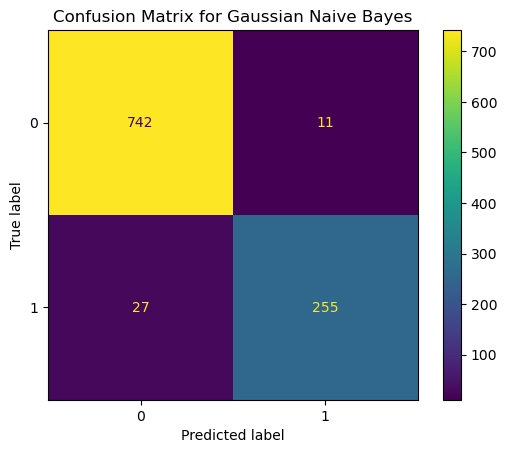

In [69]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
cm = confusion_matrix(y_test, y_pred_GNB, labels=GNB.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=GNB.classes_)
disp.plot()
plt.gca().grid(False)
plt.title('Confusion Matrix for Gaussian Naive Bayes')

In [70]:
from sklearn.metrics import classification_report
print(classification_report(y_test, y_pred_GNB, target_names=label_name))

              precision    recall  f1-score   support

         Ham       0.96      0.99      0.98       753
        Spam       0.96      0.90      0.93       282

    accuracy                           0.96      1035
   macro avg       0.96      0.94      0.95      1035
weighted avg       0.96      0.96      0.96      1035



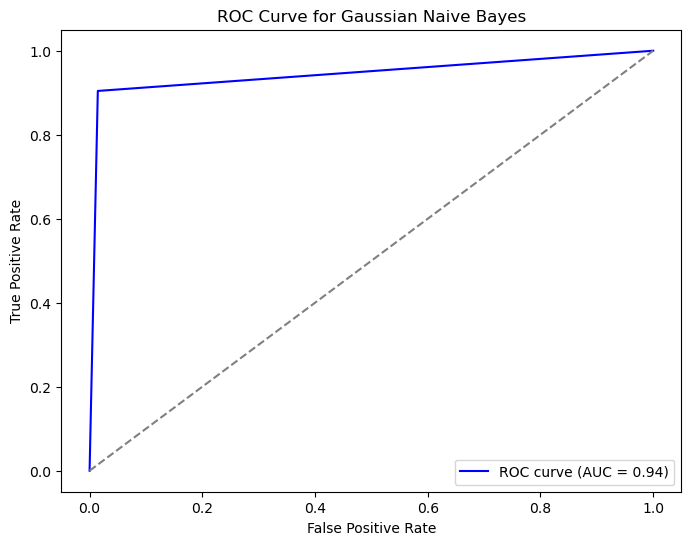

In [71]:
from sklearn.metrics import roc_curve, roc_auc_score

le = LabelEncoder()
# y_train = le.fit_transform(y_train)
# y_test = le.transform(y_test)

y_pred_GNB_proba = GNB.predict_proba(X_test)[:, 1]
fpr, tpr, thresholds = roc_curve(le.fit_transform(y_test), y_pred_GNB_proba)

# Tính AUC
roc_auc = roc_auc_score(le.fit_transform(y_test), y_pred_GNB_proba)

# Vẽ đồ thị ROC
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='blue', label=f'ROC curve (AUC = {roc_auc:.2f})')
plt.plot([0, 1], [0, 1], color='gray', linestyle='--')  # Đường chéo để tham chiếu
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve for Gaussian Naive Bayes')
plt.legend(loc="lower right")
plt.show()

In [72]:
import xgboost as xgb

train_data = xgb.DMatrix(X_train, label=y_train)
test_data = xgb.DMatrix(X_test, label=y_test)
val_data = xgb.DMatrix(X_val, label=y_val)

In [73]:
params = {
    'booster': 'gbtree',           # gbtree (cây quyết định) hoặc gblinear (mô hình tuyến tính)
    'objective': 'binary:logistic',# Phân loại nhị phân
    'eval_metric': 'auc',          # Thước đo đánh giá (AUC, error, logloss,...)

    'eta': 0.05,                   # Tốc độ học, thường từ 0.01 đến 0.3
                                   # Giảm eta => Tăng độ chính xác, cần nhiều vòng lặp (rounds) hơn
    'max_depth': 5,                # Độ sâu cây; cao quá dễ overfitting
    'min_child_weight': 3,         # Số mẫu tối thiểu cho mỗi leaf; tăng => giảm overfitting
    'gamma': 0.1,                  # Mức độ phạt khi thêm leaf; tăng => giảm overfitting

    'subsample': 0.8,              # Tỷ lệ mẫu (rows) dùng cho mỗi cây
    'colsample_bytree': 0.8,       # Tỷ lệ cột (features) dùng cho mỗi cây

    'lambda': 1,                   # L2 regularization (mặc định =1). Tăng giúp giảm overfitting
    'alpha': 0,                    # L1 regularization (mặc định =0). Tăng giúp "sparse hóa" mô hình

    'seed': 2004,                  # Để tái hiện kết quả
    'nthread': -1,                 # Sử dụng tất cả CPU cores

    'tree_method': 'hist'          # 'hist' hoặc 'gpu_hist' (nếu có GPU) thường nhanh hơn
}


In [74]:
bst = xgb.train(
    params=params,
    dtrain=train_data,
    num_boost_round=1000,               # Số vòng huấn luyện tối đa
    evals=[(val_data, "validation")],       # Tập validation để theo dõi
    early_stopping_rounds=50            # Dừng sớm sau 50 vòng không cải thiện
)

[0]	validation-auc:0.90806
[1]	validation-auc:0.93896
[2]	validation-auc:0.94651
[3]	validation-auc:0.94696
[4]	validation-auc:0.94755
[5]	validation-auc:0.95091
[6]	validation-auc:0.95580
[7]	validation-auc:0.95659
[8]	validation-auc:0.95726
[9]	validation-auc:0.95683
[10]	validation-auc:0.95662
[11]	validation-auc:0.95623
[12]	validation-auc:0.95634
[13]	validation-auc:0.95711
[14]	validation-auc:0.95657
[15]	validation-auc:0.96286
[16]	validation-auc:0.97044
[17]	validation-auc:0.97092
[18]	validation-auc:0.97090
[19]	validation-auc:0.97098
[20]	validation-auc:0.97066
[21]	validation-auc:0.97086
[22]	validation-auc:0.97272
[23]	validation-auc:0.97259
[24]	validation-auc:0.97291
[25]	validation-auc:0.97533
[26]	validation-auc:0.97595
[27]	validation-auc:0.97581
[28]	validation-auc:0.97594
[29]	validation-auc:0.97615
[30]	validation-auc:0.97637
[31]	validation-auc:0.97645
[32]	validation-auc:0.97681
[33]	validation-auc:0.97670
[34]	validation-auc:0.97788
[35]	validation-auc:0.97782
[3

In [75]:
y_pred_prob = bst.predict(test_data)

# Evaluate
y_pred = (y_pred_prob >= 0.5).astype(int)  # Điều chỉnh ngưỡng nếu cần

# Tính độ chính xác
accuracy = accuracy_score(y_test, y_pred)
print(f"Accuracy: {accuracy:.4f}")



Accuracy: 0.9623


In [76]:
from sklearn.metrics import classification_report
print(classification_report(y_test, y_pred, target_names=label_name))

              precision    recall  f1-score   support

         Ham       0.99      0.95      0.97       753
        Spam       0.89      0.99      0.93       282

    accuracy                           0.96      1035
   macro avg       0.94      0.97      0.95      1035
weighted avg       0.97      0.96      0.96      1035



In [77]:
import xgboost as xgb
from sklearn.metrics import roc_curve, auc
import matplotlib.pyplot as plt
fpr, tpr, thresholds = roc_curve(y_test, y_pred_prob)

# Tính AUC
roc_auc = auc(fpr, tpr)
print("AUC:", roc_auc)

AUC: 0.9919518144914432


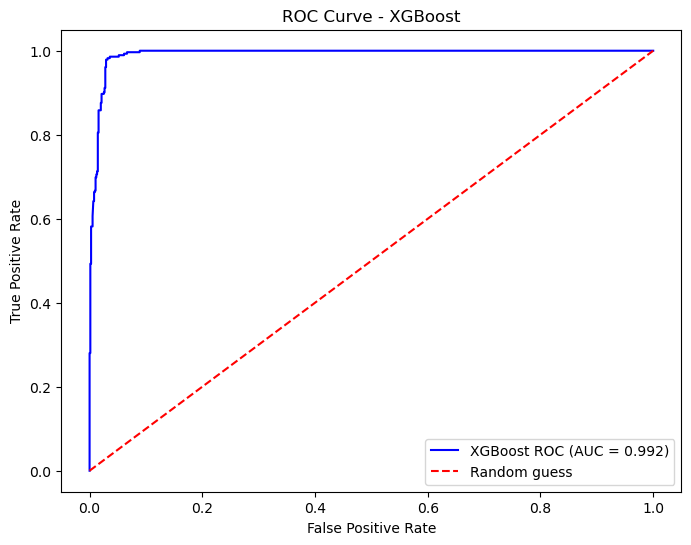

In [78]:
plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='blue', label='XGBoost ROC (AUC = %0.3f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='red', linestyle='--', label='Random guess')

plt.title('ROC Curve - XGBoost')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend(loc='lower right')
plt.show()

In [53]:
from sklearn.svm import SVC
svc = SVC()
svc.fit(X_train, y_train)
y_pred_SVC = svc.predict(X_test)
print(f'Accuracy on test set: {svc.score(X_test, y_test)}')

Accuracy on test set: 0.9256038647342996


In [56]:
label_name = ['Ham', 'Spam']

In [57]:
from sklearn.metrics import classification_report
print(classification_report(y_test, y_pred_SVC, target_names=label_name))

              precision    recall  f1-score   support

         Ham       0.99      0.91      0.95       753
        Spam       0.80      0.97      0.88       282

    accuracy                           0.93      1035
   macro avg       0.89      0.94      0.91      1035
weighted avg       0.94      0.93      0.93      1035



Text(0.5, 1.0, 'Confusion Matrix for Support Vector Machine')

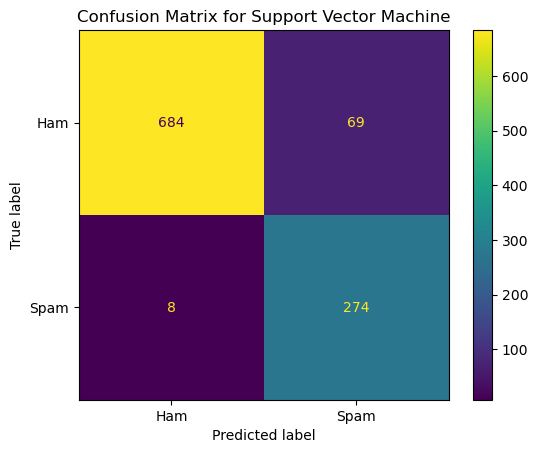

In [58]:
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
cm = confusion_matrix(y_test, y_pred_SVC, labels=svc.classes_)
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=label_name)
disp.plot()
plt.gca().grid(False)
plt.title('Confusion Matrix for Support Vector Machine')

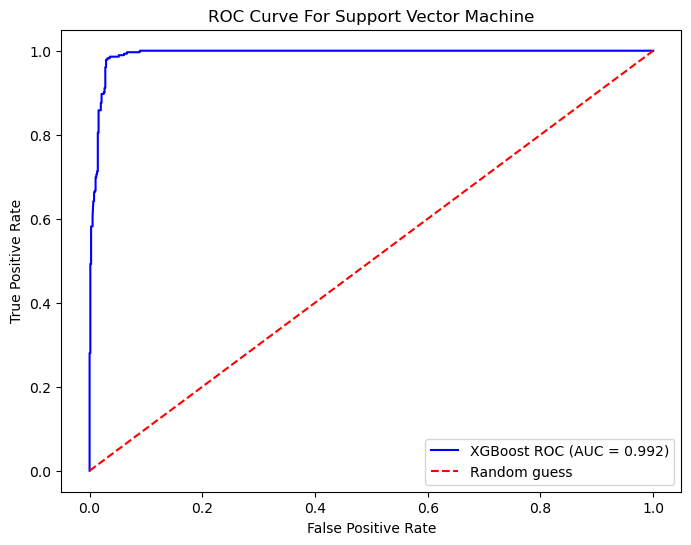

In [83]:
fpr, tpr, thresholds = roc_curve(y_test, y_pred_prob)

plt.figure(figsize=(8, 6))
plt.plot(fpr, tpr, color='blue', label='XGBoost ROC (AUC = %0.3f)' % roc_auc)
plt.plot([0, 1], [0, 1], color='red', linestyle='--', label='Random guess')

plt.title('ROC Curve For Support Vector Machine')
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.legend(loc='lower right')
plt.show()